<a href="https://colab.research.google.com/github/DavidEmeryUofC/DavidEmeryUofC/blob/main/NEWZEALAND_M01_XGB_MineralPrediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Apply ML and plot results¶
Input well information, standardize log names, scale, and execute ML model.

Written by [David Emery](https://www.linkedin.com/in/david-emery-54659a3a/)

In [ ]:
# To supress warnings and deprecated messages
import warnings
warnings.filterwarnings("ignore")

# Core routines
import numpy as np
import pandas as pd
import time

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt

#from pputilities import *

## Setup default colour and plot size

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
density_colors = ['white', 'lightgrey', 'skyblue', 'green', 'yellow', 'gold', 'darkorange', 'red', 'DarkRed', 'violet']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wbgr', density_colors))
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wbgr_trans', density_colors, gamma=np.linspace(1, 0, 256)))

# Colour map for displaying GR from yellow to grey 
gammaray_colors = ['salmon','yellow', 'lightgreen','lightgrey', 'silver','gray','slategrey']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('gr_color', gammaray_colors))

# Colour map for highlighting confusion matrix
confusion_colors = ['white', 'yellow', 'green', 'skyblue', 'blue']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wygb', confusion_colors))

# Default figure size for use in Powerpoint
plt.rcParams['figure.figsize'] = (10, 7)
plt.rcParams['figure.dpi'] = 144
plt.tight_layout()

# Default font size
SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 14

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

<Figure size 1440x1008 with 0 Axes>

## Import log data

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
# Setting up pointer to my google drive 
#filename = input('Enter the input.csv file name ')
#if filename == '':
MYPATH = "/content/gdrive/MyDrive/MLPetrophysical/"
MYMPATH = "/content/gdrive/MyDrive/MLmodels/"

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
filename = MYPATH + 'NZmergedData.csv'
data = pd.read_csv(filename, delimiter=";")

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
DEPTH,2535236.0,2167.705193,1264.341519,-0.010000,1133.856000,2055.191900,3146.800000,5999.988100
BS,1582090.0,12.349498,4.012377,0.000000,8.500000,12.250000,12.250000,36.000000
CALI,1594183.0,12.152259,4.476353,-4.738400,8.831000,12.339100,13.997500,35.987224
GR,2016461.0,78.409386,28.280721,0.000000,58.695312,76.179611,98.477233,294.699973
RDEP,1748736.0,175.035571,2699.385221,0.000200,2.184382,4.742571,10.191000,99999.000000
RMED,1070758.0,66.559859,396.695848,0.052246,2.594723,5.143121,10.318875,90927.630000
RSHA,565758.0,72.718930,118.651855,0.099990,13.580350,75.347000,93.500000,2000.000000
NPHI,658712.0,0.283421,0.109093,0.000200,0.215100,0.282715,0.343500,0.699900
RHOB,1214441.0,2.399019,0.212578,1.004883,2.291000,2.434000,2.555000,3.200000
DTC,1778507.0,93.471392,30.478095,35.002520,73.790398,85.890530,104.150002,299.992490


In [ ]:
data.dropna(subset=['WELL'],inplace=True)
data.dropna(subset=['GR'],inplace=True)
data.dropna(subset=['RDEP'],inplace=True)
data.dropna(subset=['DTC'],inplace=True)
data.reset_index(inplace=True)
data.shape

(1480645, 15)

In [ ]:
data.head()

,index,WELL,DEPTH,BS,CALI,GR,RDEP,RMED,RSHA,NPHI,RHOB,DTC,DTS,PEF,SP
0,7884,ARIKI-1,476.8000,26.0,17.5938,47.024460,1.012775,1.2685,NaN,NaN,1.909,155.05299,NaN,NaN,-23.7812
1,7885,ARIKI-1,476.8596,26.0,17.5938,47.253460,0.712400,1.2685,NaN,NaN,1.909,155.05299,NaN,NaN,-23.7812
2,7886,ARIKI-1,476.9000,26.0,17.5938,47.253460,1.012775,1.2685,NaN,NaN,1.909,155.05299,NaN,NaN,-23.7812
3,7887,ARIKI-1,477.0000,26.0,17.7188,46.740281,0.880552,1.2574,NaN,NaN,1.902,161.04900,NaN,NaN,-23.2969
4,7888,ARIKI-1,477.0120,26.0,17.7188,46.740281,0.682400,1.2574,NaN,NaN,1.902,161.04900,NaN,NaN,-23.2969


### Determine the number of wells in the file

In [ ]:
Wells = data.WELL.unique()
print(f"There are {len(Wells)} wells in the file")

There are 48 wells in the file


##Create missing logs & attributes

In [ ]:
LOGS = ['WELL','DEPTH',
        'GR','RDEP','RMED','RSHA','NPHI','RHOB','DTC','DTS','PEF','SP']
# Determine the logs contained in the file
for item in LOGS:
  if not item in data.columns:
    print('creating ' + item) 
    data[item] = np.nan

###Take the log of the resistivity

In [ ]:
data['RDEP'] = np.log10(data['RDEP'])
data['RMED'] = np.log10(data['RMED'])
data['RSHA'] = np.log10(data['RSHA'])

In [ ]:
if not 'Vp' in data.columns:
  print('Create Vp')
  data['Vp'] = 1000000 / (3.2808 * data['DTC'])
if not 'Vs' in data.columns:
  print('Create Vs')
  data['Vs'] = 1000000 / (3.2808 * data['DTS'])  

Create Vp
Create Vs


###Drop point withut GR, RMED and

In [ ]:
data.shape

(1480645, 17)

In [ ]:
Wells = data.WELL.unique()
print(f"There are {len(Wells)} wells in the file")

There are 48 wells in the file


###De-spike using Medium filter of GR, DTC, DTS, NPHI, RHOB, PEF

In [ ]:
from scipy.signal import medfilt
FILTER = ['GR','Vp','Vs','NPHI','RHOB','PEF']
for item in FILTER:
  print('Filtering ',item)
  for well in Wells:
    data[item][data[item][data.WELL == well].index] = medfilt(data[item][data.WELL == well], 7)


Filtering  GR
Filtering  Vp
Filtering  Vs
Filtering  NPHI
Filtering  RHOB
Filtering  PEF


###Remove non-sedimentary values

In [ ]:
data.GR[data.GR >= 250   ] = 250     # GR 150 for a 100% clay
data.GR[data.GR <= 0     ] = 0       # GR <0 not possible
data.RHOB[data.RHOB >= 3.2 ] = np.nan  # Density above 4 unlikely to exist in sedimentary rocks
data.RHOB[data.RHOB <= 1 ] = np.nan  # Density less than water should not exist
data.PEF[data.PEF >= 8   ] = np.nan  # Should not exist if correctly scaled
data.PEF[data.PEF <= 0.1 ] = np.nan  # Should not exist if correctly scaled
data.DTC[data.DTC >= 300 ] = np.nan  # Should not exist as 250 = 1220 m/sec < water
data.DTC[data.DTC <= 35  ] = np.nan  # Should not exist as 35 = 8700 m/sec > all sedimentary rocks
data.DTS[data.DTS >= 650 ] = np.nan  # Unlikely shear velocity < 500 m/s
data.DTS[data.DTS <= 65  ] = np.nan  # Unlikely shear velocity > 5000 m/s   
data.Vp[data.Vp >= 7000 ] = np.nan  # Should not exist as 250 = 1220 m/sec < water
data.Vp[data.Vp <= 1450  ] = np.nan  # Should not exist as 35 = 8700 m/sec > all sedimentary rocks
data.Vs[data.Vs >= 3500 ] = np.nan  # Unlikely shear velocity > 3500 m/s
data.Vs[data.Vs <= 300  ] = np.nan  # Unlikely shear velocity < 500 m/s       
data.NPHI[data.NPHI >= 0.8 ] = np.nan  # Unlikely porosity reading even for shales
data.NPHI[data.NPHI <= -0.1  ] = np.nan  # Physically impossible porosity 

### SP log standarization

In [ ]:
print('Rescaling SP by subtracting medium and scaling using STD')
from scipy.signal import medfilt
data['SP_N'] = data.SP
for well in Wells:
    data.SP_N[data[data.WELL == well].SP_N.index] = data[data.WELL == well].SP_N - medfilt(data[data.WELL == well].SP_N,151)
    data.SP[data[data.WELL == well].SP.index] = 3 * data[data.WELL == well].SP_N / np.nanstd(data[data.WELL == well].SP_N)
    
data.drop(columns=['SP_N'],inplace=True)

data.SP[data.SP >= 30 ] = 30  # Unlikely porosity reading even for shales
data.SP[data.SP <= -30  ] = -30  # Physically impossible porosity 

Rescaling SP by subtracting medium and scaling using STD


### Density Porosity (DPHI)

In [ ]:
if not 'DPHI' in data.columns:
  print('Create DPHI')
  data['DPHI'] = 1 - (data['RHOB'] - 1)/(2.72 - 1)
  data.DPHI[data.DPHI >= 0.8 ] = np.nan  # Unlikely porosity reading even for shales
  data.DPHI[data.DPHI <= -0.1  ] = np.nan  # Physically impossible porosity
if not 'NPHI-DPHI' in data.columns:
  print('Create NPHI-DPHI')
  data['NPHI-DPHI'] = data.NPHI - data.DPHI


Create DPHI
Create NPHI-DPHI


In [ ]:
if not 'TVD' in data.columns:
  print('Create TVD')
  data['TVD'] = (data.DEPTH - 18.4) * (-0.969) 

Create TVD


##Create residual attributes

In [ ]:
print('Create Residual curves')
if not 'GR_RES' in data.columns:
  print('Create GR_RES')
  data['GR_RES'] = data.GR - (62 - 0.0025 * data.TVD)

if not 'RDEP_RES' in data.columns:
  print('Create RDEP_RES')
  data['RDEP_RES'] = data.RDEP - (-0.116 - 0.000192 * data.TVD)

if not 'NPHI_RES' in data.columns:
  print('Create NPHI_RES')
  data['NPHI_RES'] = data.NPHI - (0.505 + 0.0000744 * data.TVD)

if not 'RHOB_RES' in data.columns:
  print('Create RHOB_RES')
  data['RHOB_RES'] = data.RHOB - (1.86 - 0.00019 * data.TVD)

if not 'DPHI_RES' in data.columns:
  print('Create DPHI_RES')
  data['DPHI_RES'] = data.RHOB - (0.5 - 0.00011 * data.TVD)

if not 'Vp_RES' in data.columns:
  print('Create Vp_RES')
  data['Vp_RES'] = data.Vp - (1588 - 0.60 * data.TVD)

if not 'Vs_RES' in data.columns:
  print('Create Vs_RES')
  data['Vs_RES'] = data.Vs - (847 - 0.287 * data.TVD)

if not 'PEF_RES' in data.columns:
  data['PEF_RES'] = data.PEF - (3.35 - 0.00038642 * data.TVD)

Create Residual curves
Create GR_RES
Create RDEP_RES
Create NPHI_RES
Create RHOB_RES
Create DPHI_RES
Create Vp_RES
Create Vs_RES


Remove any residual shift from the residual using the median

In [ ]:
Curves = ['GR_RES','RDEP_RES','NPHI_RES','RHOB_RES','Vp_RES','Vs_RES','PEF_RES']
for well in Wells:
  for curve in Curves:
    data[curve][data[data.WELL == well].TVD.index] = data[curve][data.WELL == well] - np.nanmedian(data[curve][data.WELL == well])

###Display the histogram after unit editting

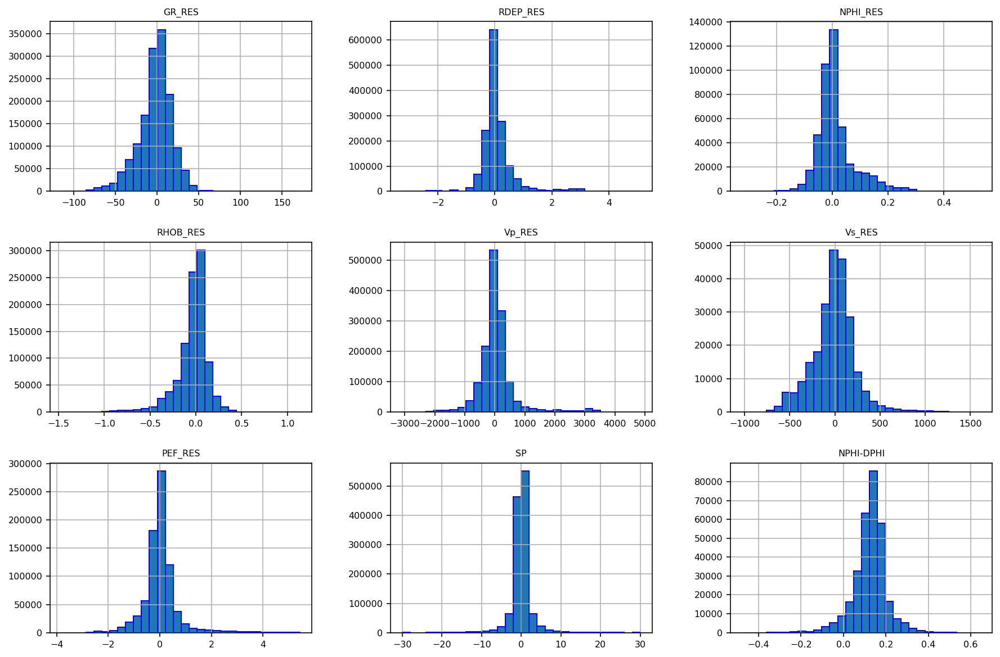

In [ ]:
Features = ['GR_RES','RDEP_RES','NPHI_RES','RHOB_RES','Vp_RES','Vs_RES','PEF_RES','SP','NPHI-DPHI']
data[Features].hist(bins=30,figsize=(15,10),edgecolor='b')
plt.show;

## Normalized Logs
by adding back in the trend


In [ ]:
print('Create Normalized logs from Residual curves')
data.GR = data.GR_RES + (62 - 0.0025 * data.TVD)

data.RDEP = data.RDEP_RES + (-0.116 - 0.000192 * data.TVD)

data.NPHI = data.NPHI_RES + (0.505 + 0.0000744 * data.TVD)
data.RHOB = data.RHOB_RES + (1.86 - 0.00019 * data.TVD)
data.DPHI = data.RHOB_RES + (0.5 - 0.00011 * data.TVD)

data.Vp = data.Vp_RES + (1588 - 0.60 * data.TVD)
data.Vs = data.Vs_RES + (847 - 0.287 * data.TVD)

data.DTC = 1000000/(3.2808*data.Vp)
data.DTS = 1000000/(3.2808*data.Vs)

data.PEF = data.PEF_RES + (3.35 - 0.00038642 * data.TVD)

Create Normalized logs from Residual curves


##Routine for crossplotting two curves displaying density of the points (log_crossplot)

In [ ]:
def log_crossplot (x,y,nameX,nameY,cMap1='wbgr_trans',order=2, lplot=False, intercept=0.0, slope=1.0, pow=1, scaler=1):
    from sklearn.linear_model import LinearRegression
    from sklearn.preprocessing import PolynomialFeatures
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt   
    from sklearn.metrics import r2_score
    from sklearn.metrics import mean_squared_error

    # Remove nan point from input
    df = pd.DataFrame({nameX:x,nameY:y})
    df.dropna(axis=0,inplace=True)
    num_points = len(df)
    lineP = True
    
    # Create density plot
    heatmap, xedges, yedges = np.histogram2d(df[nameX], df[nameY], bins=250)
    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
    
    # Create trend line for data
    Xmin = np.percentile(df[nameX],2.5)
    Xmax = np.percentile(df[nameX],98.5)
    Xline = np.arange(Xmin,Xmax,(Xmax-Xmin)/100)
    Zline = intercept + slope*np.power((scaler * Xline),pow)
    
    model = LinearRegression()
    X = df[nameX].to_numpy()
    X = X.reshape(-1,1)
    Y = df[nameY].to_numpy()
    Y = Y.reshape(-1,1)
    
    # only will display relationships upto the 4th order 
    if order >= 2 :
        poly_reg = PolynomialFeatures(degree = order)
        X_poly = poly_reg.fit_transform(X,Y)
        model.fit(X_poly,Y)
        Yline = model.predict(poly_reg.fit_transform(Xline.reshape(-1,1)))
        r2 = model.score(X_poly,Y)
        intercept = model.intercept_
        parm = model.coef_
        if order == 2:
            ctext = str(str(round(float(intercept),2)) + ' + ' + str(round(float(parm[:,1]),3))
                    + '*X + ' +str(round(float(parm[:,2]),5)) + '*X2  r2=' + str(round(float(r2),2)))
        elif order == 3:
            ctext = str(str(round(float(intercept),2)) + ' + ' + str(round(float(parm[:,1]),3))
                    + '*X + ' +str(round(float(parm[:,2]),5)) + '*X2 + '
                    +  str(round(float(parm[:,3]),7)) + '*X3  r2=' + str(round(float(r2),2)))
        elif order == 4: 
            ctext = str(str(round(float(intercept),2)) + ' + ' + str(round(float(parm[:,1]),3))
                    + '*X + ' +str(round(float(parm[:,2]),5)) + '*X2 + '
                    + str(round(float(parm[:,3]),7)) + '*X3 + ' 
                    + str(round(float(parm[:,4]),9)) + '*X4  r2=' + str(round(float(r2),2)))
    elif order == 1:
        model.fit(X,Y)
        Yline = model.predict(Xline.reshape(-1,1))
        r2 = model.score(X,Y)
        intercept = model.intercept_
        parm = model.coef_
        ctext = str('intercept ' + str(round(float(intercept),2)) + ' slope ' +
                    str(round(float(parm),4)) + '  r2=' + str(round(float(r2),2)))
    else :
        lineP = False
        
    plt.figure(figsize = (10,7))
    plt.title("Crossplot of " + nameX + ' and ' + nameY, fontsize=16)
    plt.grid(alpha=0.5)
    plt.xlim([np.percentile(df[nameX],0.01), np.percentile(df[nameX],99.9)])
    plt.ylim([np.percentile(df[nameY],0.01), np.percentile(df[nameY],99.9)])    
    plt.imshow(heatmap.T, extent=extent, origin='lower', cmap=cMap1, aspect='auto')
    if(lplot):
        plt.plot(Xline,Zline, c='blue', linestyle='dashed') 
    if(lineP):
        plt.plot(Xline,Yline, c='red')
        plt.text(np.percentile(df[nameX],10),np.percentile(df[nameY],1),ctext)
    plt.xlabel(nameX)
    plt.ylabel(nameY)

    plt.show()


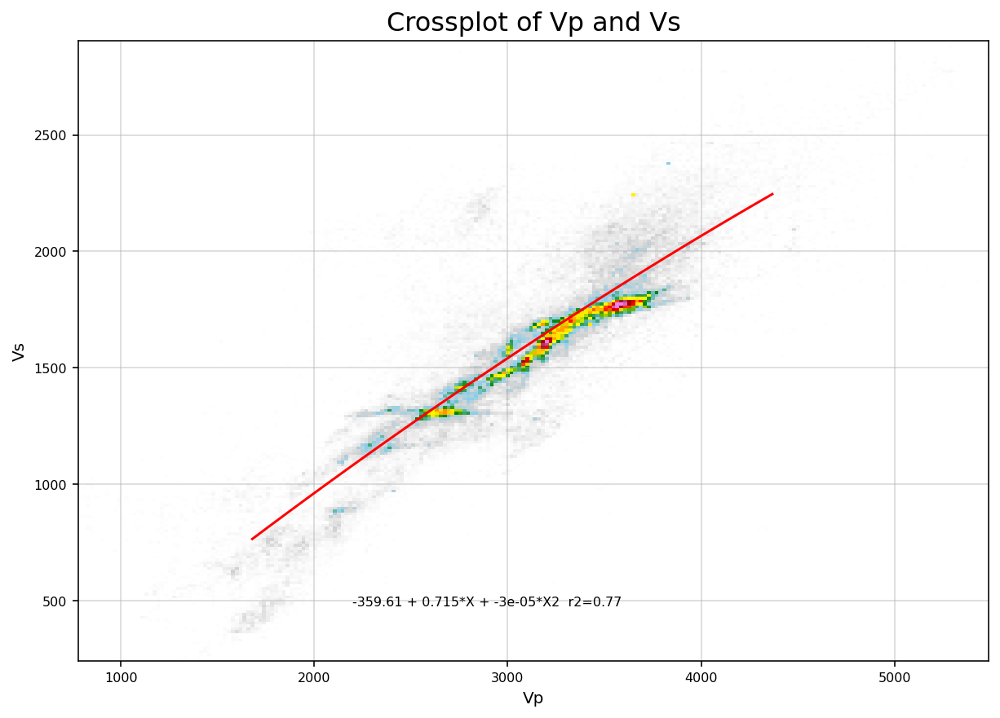

In [ ]:
nameX = 'Vp'
nameY = 'Vs'
log_crossplot(data[nameX],data[nameY],nameX,nameY,order=2)
#log_crossplot(data[nameX],data[nameY],nameX,nameY,cMap1='wbgr_trans',order=2, lplot=True, intercept=0.0, slope=1.0, pow=1, scaler=1)

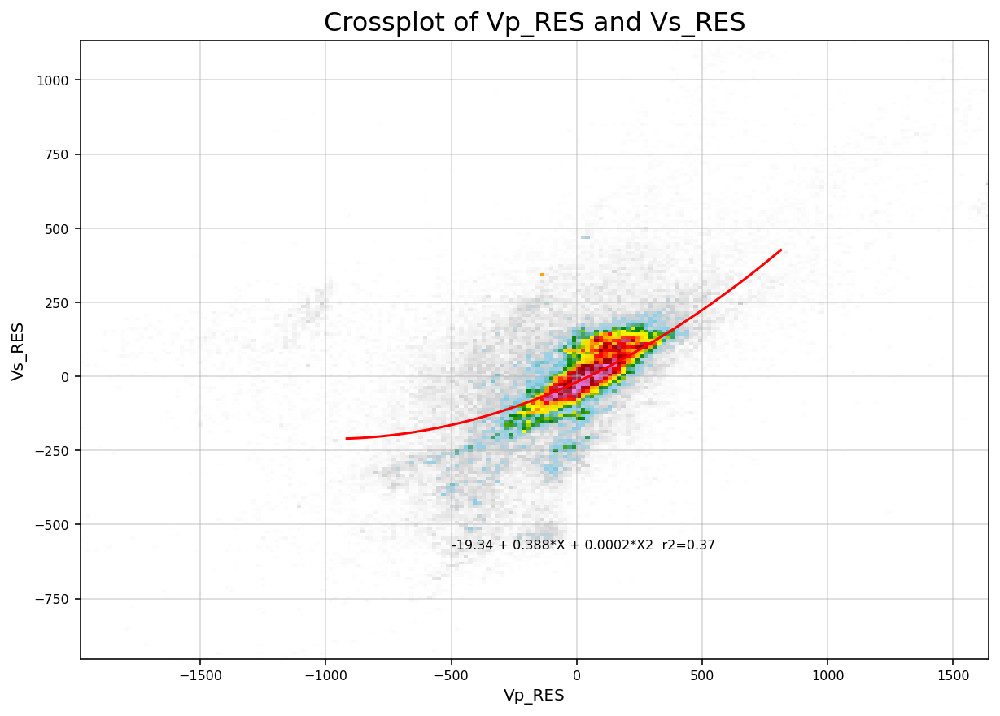

In [ ]:
nameX = 'Vp_RES'
nameY = 'Vs_RES'
log_crossplot(data[nameX],data[nameY],nameX,nameY,order=2)
#log_crossplot(data[nameX],data[nameY],nameX,nameY,cMap1='wbgr_trans',order=2, lplot=True, intercept=0.0, slope=1.0, pow=1, scaler=1)

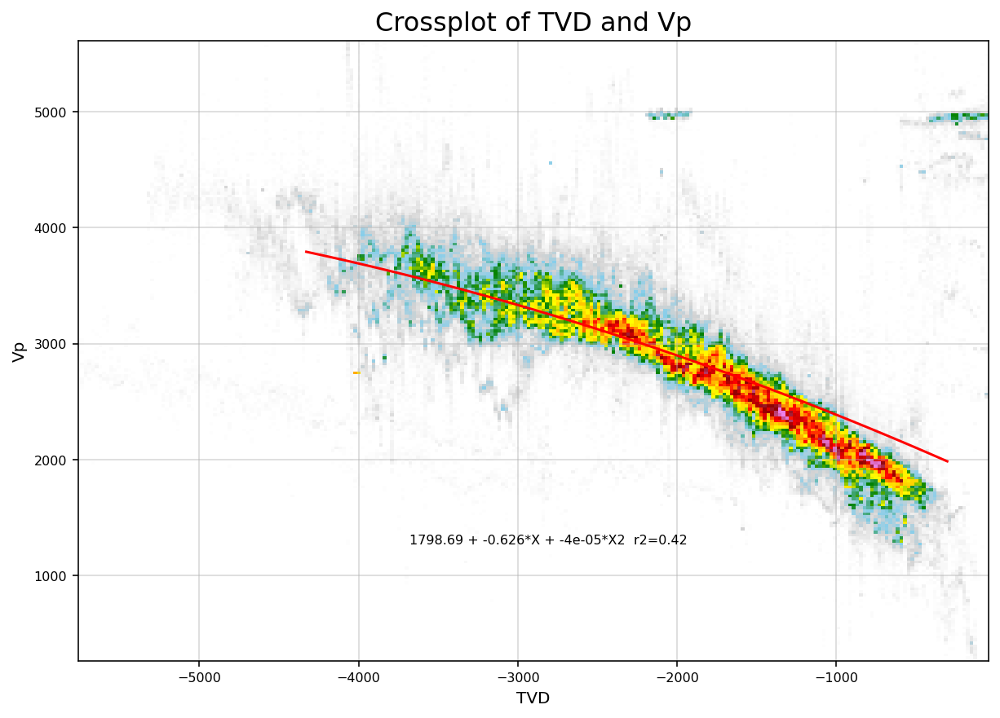

In [ ]:
nameX = 'TVD'
nameY = 'Vp'
log_crossplot(data[nameX],data[nameY],nameX,nameY,order=2)
#log_crossplot(data[nameX],data[nameY],nameX,nameY,cMap1='wbgr_trans',order=2, lplot=True, intercept=0.0, slope=1.0, pow=1, scaler=1)

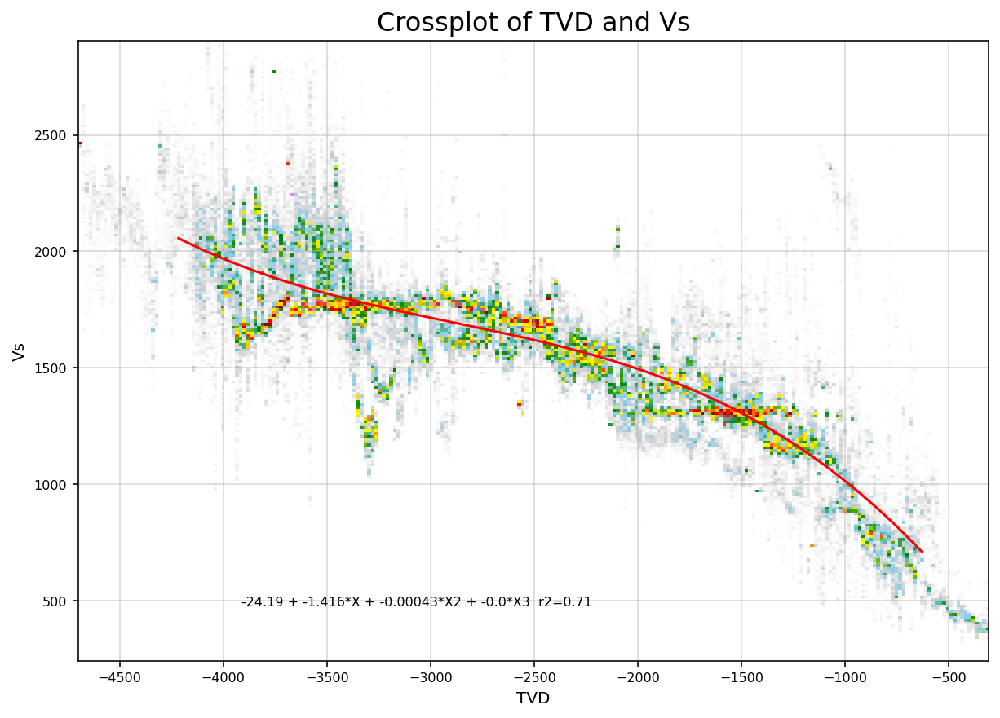

In [ ]:
nameX = 'TVD'
nameY = 'Vs'
log_crossplot(data[nameX],data[nameY],nameX,nameY,order=3)
#log_crossplot(data[nameX],data[nameY],nameX,nameY,cMap1='wbgr_trans',order=2, lplot=True, intercept=0.0, slope=1.0, pow=1, scaler=1)

#Load mineralogy XGB model classifier

In [ ]:
import xgboost as xgb
import pickle
from xgboost import XGBClassifier, plot_importance

model = xgb.XGBClassifier()

# Import Residaul based model 
#model_name = input('Enter the pre-run model file name ')
#if model_name == '':
model_name = MYMPATH + "xgb_MINResModel.pkl"

# load
xgb_model = pickle.load(open(model_name, "rb"))

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
density_colors = ['white', 'lightgrey', 'skyblue', 'green', 'yellow', 'gold', 'darkorange', 'red', 'DarkRed', 'violet']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wbgr', density_colors))
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wbgr_trans', density_colors, gamma=np.linspace(1, 0, 256)))

# Colour map for displaying GR from yellow to grey 
gammaray_colors = ['salmon','yellow', 'lightgreen','lightgrey', 'silver','gray','slategrey']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('gr_color', gammaray_colors))

### Percentage shale (Vsh)
Assumes that the clean line is 25 API units under the trend and the shale line is 35 API above the trend (range of 60)

In [ ]:
data['Vsh'] = (25 + data.GR_RES)*100/60

data.Vsh[data[data.Vsh <= 0].Vsh.index] = 0
data.Vsh[data[data.Vsh >= 100].Vsh.index] = 100

###Effective porosity (EPOR)

In [ ]:
data['NPOR'] = data.NPHI
data['DPOR'] = data.DPHI
data.NPOR.fillna((0.506+data.TVD*(0.0000741))/1, inplace=True)
data.DPOR.fillna((0.50+data.TVD*(0.00011))/1, inplace=True)
data['EPOR'] = ((data.NPOR + data.DPOR)/2)*(101-data.Vsh)/101
data.EPOR.fillna(0.01, inplace=True)
data.EPOR[data[data.EPOR <= 0].EPOR.index] = 0
data.EPOR[data[data.EPOR >= 1].EPOR.index] = 1
data.drop(columns=['NPOR','DPOR'],inplace=True)

## Run model for the calculation of mineralogy

In [ ]:
Features = ['GR_RES', 'RDEP_RES', 'NPHI_RES', 'NPHI-DPHI', 'RHOB_RES', 'Vp_RES', 'Vs_RES']
data['MINERAL_PRED'] = xgb_model.predict(data[Features])

##Establish names & colours for plotting for each lithology

In [ ]:
# Create a new dictionary for the mineralogy lithology
mineral_numbers = {1: "Cal-SS", 2: "Sandstone", 3: "Silty-SS", 4: "Silty-Shale", 5: "Shale", 6: "Organic-Shale",
                   7: "Claystone", 8: "Marlstone", 9: "Calc-Shale",10: "Arg-Limestone", 11: "Limestone",12: "P-Limestone", 
                  13: "Dolomite", 14: "Anhydrite", 15: "Halite", 16: "Tuff", 17: "Coal", 18: "Basement" }
mineral_names = ["Cal-SS", "Sandstone", "Silty-SS", "Silty-Shale", "Shale", "Organic-Shale", 
                 "Claystone", "Marlstone", "Calc-Shale", "Arg-Limestone", "Limestone", "P-Limestone", 
                 "Dolomite", "Anhydrite", "Halite", "Tuff",  "Coal", "Basement"]
mineral_colors = ['#EBEBAA','#FFFF64','#FFE17D','#D7C8B9','#C8C8C8','#A0B4A0',
                  '#e0dbd1','#D2D2EB','#96D2FF','#4BEBFF','#00FFEB','#C8FFEB',
                  '#C896FF','#FFEBFF','#96C850','#E1ACAC','#646464','#C84646']

from matplotlib.colors import LinearSegmentedColormap
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('mineral', mineral_colors))

mineral_legend = {1: {'lith':'Cal-SS',        'lith_num':1, 'hatch': '..', 'color':'#EBEBAA'},
                   2: {'lith':'Sandstone',    'lith_num':2, 'hatch': '.', 'color':'#FFFF64'},
                   3: {'lith':'Silty-SS',     'lith_num':3, 'hatch': '_.', 'color':'#FFE17D'},
                   4: {'lith':'Silty-Shale',  'lith_num':4, 'hatch':'-.',   'color':'#D7C8B9'},
                   5: {'lith':'Shale',        'lith_num':5, 'hatch':'-',   'color':'#C8C8C8'},
                   6: {'lith':'Organic-Shale','lith_num':6, 'hatch':'--',  'color':'#A0B4A0'},
                   7: {'lith':'Claystone',    'lith_num':7, 'hatch':'--',   'color':'#e0dbd1'},
                   8: {'lith':'Marlstone',    'lith_num':8,'hatch':'--',   'color':'#96D2FF'},
                   9: {'lith':'Calc-Shale',   'lith_num':9,'hatch':'-',   'color':'#D2D2EB'},
                  10: {'lith':'Arg-Limestone','lith_num':10,'hatch':'++',   'color':'#4BEBFF'},
                  11: {'lith':'Limestone',    'lith_num':11,'hatch':'+',   'color':'#00FFEB'},
                  12: {'lith':'P-Limestone',  'lith_num':12,'hatch':'+',   'color':'#C8FFEB'},
                  13: {'lith':'Dolomite',     'lith_num':13,'hatch':'-/',   'color':'#C896FF'},
                  14: {'lith':'Anhydrite',    'lith_num':14,'hatch':'**',   'color':'#FFEBFF'},
                  15: {'lith':'Halite',       'lith_num':15,'hatch':'X',   'color':'#96C850'},
                  16: {'lith':'Tuff',         'lith_num':16,'hatch':'\|',   'color':'#E1ACAC'},
                  17: {'lith':'Coal',         'lith_num':17, 'hatch':'--',   'color':'#646464'},
                  18: {'lith':'Basement',    'lith_num':18, 'hatch':'XX',    'color':'#C84646'}
}

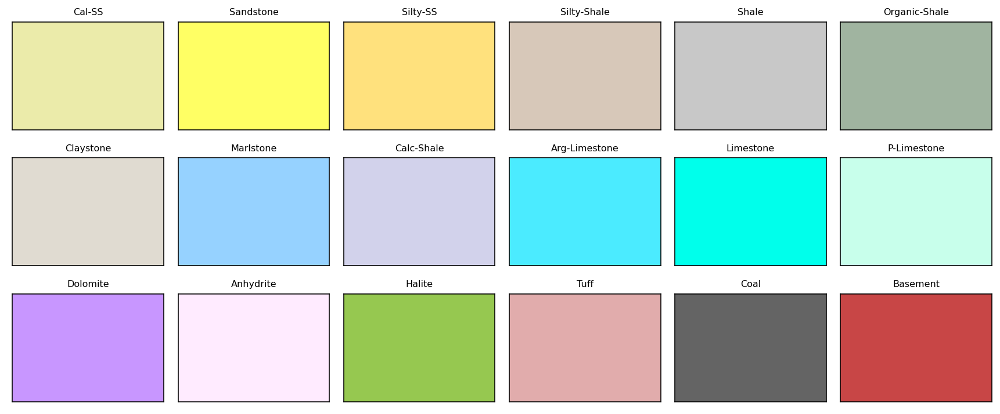

In [ ]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=6,nrows=3, sharex=True, sharey=True,
                         figsize=(12,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, mineral_legend.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=mineral_legend[key]['color'])#, hatch=mineral_legend[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(mineral_legend[key]['lith']))

plt.tight_layout()

plt.show()

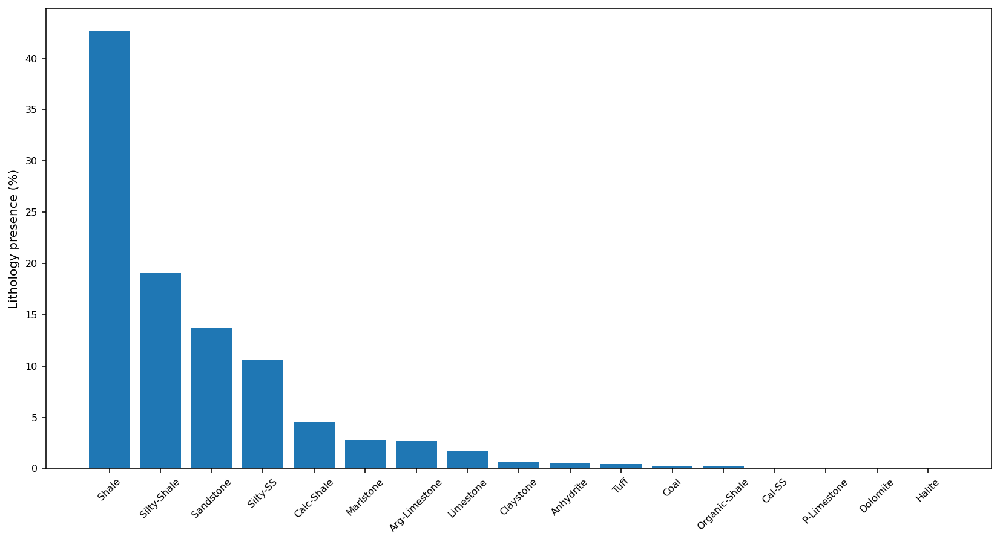

In [ ]:
# Display the Lithofacies Class by their percentage
counts = data['MINERAL_PRED'].value_counts()
names = []
percentage = []
N = data['MINERAL_PRED'].shape[0]
for item in counts.iteritems():
    names.append(mineral_numbers[item[0]])
    percentage.append(float(item[1])/N*100)
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x = np.arange(len(names)), height=percentage)
ax.set_xticklabels(names, rotation=45)
ax.set_xticks(np.arange(len(names)))
ax.set_ylabel('Lithology presence (%)');

###Create probability distribution for reduced feature set

In [ ]:
distrib =  pd.DataFrame(xgb_model.predict_proba(data[Features]), columns=mineral_names)
#predict_proba(X, ntree_limit=None, validate_features=True, base_margin=None, iteration_range=None)

distrib.describe()

,Cal-SS,Sandstone,Silty-SS,Silty-Shale,Shale,Organic-Shale,Claystone,Marlstone,Calc-Shale,Arg-Limestone,Limestone,P-Limestone,Dolomite,Anhydrite,Halite,Tuff,Coal,Basement
count,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06,1.480645e+06
mean,2.167800e-03,1.259007e-01,1.342964e-01,1.711364e-01,4.032298e-01,2.137480e-03,6.672802e-03,3.137840e-02,4.651970e-02,4.189285e-02,1.566842e-02,5.852043e-04,1.664078e-03,5.097510e-03,2.866699e-04,8.094730e-03,3.260365e-03,1.065906e-05
std,1.807749e-02,2.623599e-01,2.167233e-01,2.589808e-01,4.143896e-01,3.230512e-02,7.513527e-02,1.198233e-01,1.288887e-01,1.146059e-01,9.704869e-02,1.612420e-02,1.453308e-02,6.346224e-02,1.255962e-02,5.011915e-02,4.365697e-02,2.729220e-04
min,1.085209e-12,6.365901e-12,3.648651e-11,4.422838e-11,3.401459e-09,6.541462e-13,5.638026e-13,1.270972e-09,2.748245e-11,2.948252e-10,4.385520e-12,7.658018e-13,2.022552e-12,5.147148e-12,9.457954e-12,1.286107e-12,4.607530e-11,7.323534e-12
25%,1.056357e-06,7.321774e-07,2.110019e-03,5.654877e-04,6.223730e-03,7.547889e-09,5.504691e-08,1.026636e-04,2.678647e-05,6.308798e-04,2.688905e-07,8.330479e-09,2.559478e-06,1.834156e-08,3.977836e-09,1.460442e-05,2.581288e-07,3.694453e-08
50%,1.500024e-05,2.100521e-05,3.177495e-02,1.833513e-02,2.017950e-01,1.467925e-07,1.414853e-06,8.776482e-04,5.289084e-04,5.000856e-03,1.322514e-06,9.719739e-08,4.166972e-05,5.626099e-08,9.083020e-09,2.500393e-04,2.559072e-06,9.468479e-08
75%,1.922668e-04,7.141864e-02,1.687557e-01,2.600996e-01,8.990699e-01,4.392618e-06,1.131123e-05,5.784198e-03,1.378301e-02,2.594991e-02,1.066970e-05,1.424752e-06,3.796928e-04,1.994151e-07,3.555155e-08,1.986938e-03,2.821108e-05,2.190452e-07
max,9.997775e-01,9.999733e-01,9.999989e-01,9.995967e-01,9.999998e-01,9.999819e-01,9.999980e-01,9.995546e-01,9.980653e-01,9.971602e-01,9.997855e-01,9.950024e-01,9.745725e-01,9.999944e-01,9.999219e-01,9.992373e-01,9.999526e-01,2.052340e-01


In [ ]:
dataP = pd.concat([data, distrib], axis=1).copy()
#dataP = pd.concat([data, distrib.reindex(data.index)], axis=1)
dataP.shape

(1480645, 49)

Define routine for plotting lithology along with well logs

In [ ]:
def Lithology_log_plot(data, depth, lithology, names, colours, well_id = "Well Plot", dscale = 100, dmin = -999.25, dmax = -999.25):
    SMALL_SIZE = 8
    MEDIUM_SIZE = 10
    BIGGER_SIZE = 12

    plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
    
    if dmin == -999.25 : dmin = np.min(depth)
    if dmax == -999.25 : dmax = np.max(depth)
    dmin = dscale * round((dmin-dscale/2)/dscale,0)
    dmax = dscale * round((dmax+dscale/2)/dscale,0)

    curves_in_file = data.columns.to_list()

    # Create missing curves
    curveplots = ['BS','CALI','GR_RES','RDEP_RES','RMED_RES','NPHI_RES','RHOB_RES','Vp_RES','Vp_RES','SP','RESdiff','PEF_RES','CONFIDENCE','BAD']
    for item in curveplots:
      if item not in curves_in_file:
        data[item] = np.nan
    
    # Check for depth gaps in curves and add point with nan to split curve plots
    data['Change'] = data.DEPTH - data.DEPTH.shift(-1)
    data['Change1'] = data.Change.shift(1) - data.Change
    data['Change2'] = data.Change - data.Change.shift(-1)
    for item in curveplots:
      data[item][np.abs(data.Change2) >= 2] = np.nan
    lithology[np.abs(data.Change1) >= 2] = np.nan
    lithology[np.abs(data.Change2) >= 2] = np.nan
    data.EPOR[np.abs(data.Change1) >= 2] = np.nan
    data.EPOR[np.abs(data.Change2) >= 2] = np.nan

    # Major ticks every 20, minor ticks every 5
    major_ticks = np.arange(dmin, dmax, dscale)
    minor_ticks = np.arange(dmin, dmax, dscale/5)

    figlength = (dmax-dmin)/dscale + 1.5
    scaleoffset = 0.6/figlength

    fig, axs = plt.subplots(1, 21, figsize = (17, figlength))
    fig.suptitle("Well " + well_id, fontsize=16, y = 1)
    plt.ylim(dmax, dmin)

    #Set up the plot axes
    axs[0] = plt.subplot2grid((1,8), (0,0), rowspan=1, colspan = 1) # BS 
    axs[1] = plt.subplot2grid((1,8), (0,1), rowspan=1, colspan = 1) # RDEP
    axs[2] = plt.subplot2grid((1,8), (0,2), rowspan=1, colspan = 1) # NPHI
    axs[3] = plt.subplot2grid((1,8), (0,3), rowspan=1, colspan = 1) # DTC & DTS
    axs[4] = plt.subplot2grid((1,8), (0,4), rowspan=1, colspan = 1) # SP & RESdiff
    axs[5] = plt.subplot2grid((1,8), (0,5), rowspan=1, colspan = 1) # PEF
    axs[6] = axs[0].twiny() #Twins the y-axis for CALI on BS
    axs[7] = axs[0].twiny() #Twins the y-axis adding GR
    axs[8] = axs[1].twiny() #Twins the y-axis adding RMED on RDEP
    axs[9] = axs[2].twiny() #Twins the y-axis for the NPHI add RHOB
    axs[10] = axs[3].twiny() #Twins the y-axis for the DTC track add DTS
    axs[11] = axs[4].twiny() #Twins the y-axis for the RESdiff on SP
    axs[18] = axs[5].twiny() #Reserve pointer to add curve to PEF
    axs[19] = plt.subplot2grid((1,8), (0,6), rowspan=1, colspan = 1) # Lithology
    axs[20] = plt.subplot2grid((1,8), (0,7), rowspan=1, colspan = 1) # Litho Probability

    # As our curve scales will be detached from the top of the track,
    # this code adds the top border back in without dealing with splines
    axs[12] = axs[0].twiny()
    axs[12].xaxis.set_visible(False)
    axs[13] = axs[1].twiny()
    axs[13].xaxis.set_visible(False)
    axs[14] = axs[2].twiny()
    axs[14].xaxis.set_visible(False)
    axs[15] = axs[3].twiny()
    axs[15].xaxis.set_visible(False)
    axs[16] = axs[4].twiny()
    axs[16].xaxis.set_visible(False)
    axs[17] = axs[5].twiny()
    axs[17].xaxis.set_visible(False)

    # Gammaray track with BS and CALI
    axs[0].plot(data['BS'],depth,c="black",linewidth=0.5)
    axs[0].set_xlabel("BS (inch)")
    axs[0].xaxis.label.set_color("black")
    axs[0].set_ylabel("Depth (m)",rotation=90)
    axs[0].set_xlim([0, 30])
    axs[0].spines["top"].set_position(("axes", 1 + 1 * scaleoffset))
    axs[0].spines["top"].set_visible(True)
    axs[0].spines["top"].set_edgecolor("black")
    axs[0].set_xticks([0, 7.5, 15, 22.5, 30])

    axs[6].plot(data['CALI'],depth,c="r",linewidth=0.5)
    axs[6].set_xlabel("CALI (inch)")
    axs[6].xaxis.label.set_color("red")
    axs[6].set_xlim([0, 30])
    axs[6].spines["top"].set_position(("axes", 1 + 2 * scaleoffset))
    axs[6].spines["top"].set_visible(True)
    axs[6].spines["top"].set_edgecolor("red")
    axs[6].set_xticks([0, 7.5, 15, 22.5, 30])

    axs[7].plot(data['GR_RES'],depth,c="g",linewidth=0.5)
    axs[7].plot(data['GR_RES']+200,depth,c="darkgreen",linewidth=0.5,linestyle='dashed')
    axs[7].plot(data['GR_RES']-200,depth,c="green",linewidth=0.5,linestyle='dotted')
    axs[7].set_xlabel("GR (API)")
    axs[7].xaxis.label.set_color("green")
    axs[7].set_xlim([-100, 100])
    axs[7].spines["top"].set_position(("axes", 1 + 3 * scaleoffset))
    axs[7].spines["top"].set_visible(True)
    axs[7].spines["top"].set_edgecolor("green")
    axs[7].set_xticks([-100, -50, 0, 50, 100])

    # Resistivity track in semi log scale unless max value <10
    resMax = np.max(data.RDEP)
    axs[1].set_xlabel("RDEP")
    axs[1].xaxis.label.set_color("r")
    axs[1].plot(data['RDEP_RES'],depth,c="r",linewidth=0.5)
    axs[1].set_xlim(-3,3)
    axs[1].spines["top"].set_position(("axes", 1 + 1 * scaleoffset))
    axs[1].spines["top"].set_visible(True)
    axs[1].spines["top"].set_edgecolor("red")
    axs[1].set_xticks([-3, -2, -1, 0, 1, 2, 3])

    axs[8].plot(data['RMED_RES'],depth,c="purple",linewidth=0.5,linestyle='dashed')
    axs[8].xaxis.label.set_color("purple")
    axs[8].set_xlabel("RMED")
    axs[8].set_xlim(-3,3)
    axs[8].spines["top"].set_position(("axes", 1 + 2 * scaleoffset))
    axs[8].spines["top"].set_visible(True)
    axs[8].spines["top"].set_edgecolor("purple")
    axs[8].set_xticks([-3, -2, -1, 0, 1, 2, 3])

    # NPHI and Density track
    axs[2].set_xlabel("NPHI (v/v)")
    axs[2].xaxis.label.set_color("r")
    axs[2].plot(data['NPHI_RES'],depth,c="r",linewidth=0.5)
    axs[2].plot(data['NPHI_RES']-0.6,depth,c="salmon",linewidth=0.5,linestyle='dashed')
    axs[2].plot(data['NPHI_RES']+0.6,depth,c="salmon",linewidth=0.5,linestyle='dotted')
    axs[2].set_xlim([0.3, -0.3])
    axs[2].spines["top"].set_position(("axes", 1 + scaleoffset))
    axs[2].spines["top"].set_visible(True)
    axs[2].spines["top"].set_edgecolor("red")
    axs[2].set_xticks([0.2, 0.1, 0, -0.1, -0.2]) 

    axs[9].set_xlabel("RHOB (gm/cc3)")
    axs[9].xaxis.label.set_color("g")
    axs[9].plot(data['RHOB_RES'],depth,c="g",linewidth=0.5)
    axs[9].plot(data['RHOB_RES']+1.2,depth,c="darkgreen",linewidth=0.5,linestyle='dashed')
    axs[9].plot(data['RHOB_RES']-1.2,depth,c="green",linewidth=0.5,linestyle='dotted')
    axs[9].set_xlim([-.6, 0.6])
    axs[9].spines["top"].set_position(("axes", 1 + 2 * scaleoffset))
    axs[9].spines["top"].set_visible(True)
    axs[9].spines["top"].set_edgecolor("g")
    axs[9].set_xticks([-0.6, -0.3, 0, 0.3, 0.6])

    # Slowness track
    axs[3].plot(data['Vs_RES'],depth,c="r",linewidth=0.5)
    axs[3].plot(data['Vs_RES']+2500,depth,c="salmon",linewidth=0.5,linestyle = 'dashed')
    axs[3].plot(data['Vs_RES']-2500,depth,c="lightsalmon",linewidth=0.5,linestyle = 'dotted')
    axs[3].set_xlabel("Vs (m/s)")
    axs[3].xaxis.label.set_color("r")
    axs[3].set_xlim([-1250, 1250])
    axs[3].spines["top"].set_position(("axes", 1 + scaleoffset))
    axs[3].spines["top"].set_visible(True)
    axs[3].spines["top"].set_edgecolor("red")
    axs[3].set_xticks([-1000, -500, 0, 500, 1000])

    axs[10].plot(data['Vp_RES'],depth,c="b",linewidth=0.5)
    axs[10].plot(data['Vp_RES']+5000,depth,c="royalblue",linewidth=0.5,linestyle ='dashed')
    axs[10].plot(data['Vp_RES']-5000,depth,c="royalblue",linewidth=0.5,linestyle ='dotted')
    axs[10].set_xlabel("Vp (m/s)")
    axs[10].xaxis.label.set_color("b")
    axs[10].set_xlim([-2500, 2500])    
    axs[10].spines["top"].set_position(("axes", 1 + 2 * scaleoffset))
    axs[10].spines["top"].set_visible(True)
    axs[10].spines["top"].set_edgecolor("blue")
    axs[10].set_xticks([-2000,-1000,0,1000,2000])

    # SP and RESdiff track
    axs[11].plot(data['SP'],depth,c="cyan",linewidth=0.5)
    axs[11].set_xlabel("SP")
    axs[11].xaxis.label.set_color("cyan")
    axs[11].set_xlim([-30, 30])
    axs[11].spines["top"].set_position(("axes", 1 + 2 * scaleoffset))
    axs[11].spines["top"].set_visible(True)
    axs[11].spines["top"].set_edgecolor("cyan")
    axs[11].set_xticks([-30, -15, 0, 15, 30])

    axs[4].plot(data['RESdiff'],depth,c="purple",linewidth=0.5)
    axs[4].set_xlabel("RESdiff")
    axs[4].set_xlim([-2, 2])
    axs[4].xaxis.label.set_color("purple")
    axs[4].spines["top"].set_position(("axes", 1 + 1 * scaleoffset))
    axs[4].spines["top"].set_visible(True)
    axs[4].spines["top"].set_edgecolor("purple")
    axs[4].set_xticks([-2, -1, 0, 1, 2])

    # PEF track
    axs[18].plot(data['CONFIDENCE'],depth,c="red",linewidth=0.5)
    axs[18].plot(data['BAD'],depth,c="orange",linewidth=0.5)
    axs[18].set_xlabel("CONFIDENCE")
    axs[18].set_xlim([1, 5])
    axs[18].xaxis.label.set_color("red")
    axs[18].spines["top"].set_position(("axes", 1 + 2 * scaleoffset))
    axs[18].spines["top"].set_visible(True)
    axs[18].spines["top"].set_edgecolor("red")
    axs[18].set_xticks([1,3,5])

    axs[5].plot(data['PEF_RES'],depth,c="green",linewidth=0.5)
    axs[5].set_xlabel("PEF")
    axs[5].set_xlim([-2, 2])
    axs[5].xaxis.label.set_color("green")
    axs[5].spines["top"].set_position(("axes", 1 + 1 * scaleoffset))
    axs[5].spines["top"].set_visible(True)
    axs[5].spines["top"].set_edgecolor("green")
    axs[5].set_xticks([-2,-1,0,1,2])
    
    proba_old = depth * 0 
    for i in range(len(names)):
      yplot = depth * 0
      yplot[lithology == i+1] = 1
      axs[19].fill_betweenx(depth, 0, yplot, color=colours[i])
      axs[19].set_ylim(dmax, dmin)
      axs[19].set_xlim([0, 1]) 
    axs[19].set_xlabel("Lithology")
    axs[19].xaxis.label.set_color("black")
    axs[19].set_xlim(0,1)
    axs[19].set_ylim(dmax, dmin)
    axs[19].spines["top"].set_position(("axes", 1 + 1 * scaleoffset))
    axs[19].spines["top"].set_visible(True)
    axs[19].spines["top"].set_edgecolor("black")
    axs[19].set_xticks([])

    proba_old = depth * 0 
    for i in range(len(names)):
      proba_new = data[names[i]]*(1-data.EPOR) + proba_old
      axs[20].fill_betweenx(depth,proba_old,proba_new,color=colours[i])
      proba_old = proba_new

    axs[20].fill_betweenx(depth,proba_old,1,color='white')
    axs[20].set_xlabel("Mineral Fraction")
    axs[20].xaxis.label.set_color("black")
    axs[20].set_xlim(0,1)
    axs[20].set_ylim(dmax, dmin)
    axs[20].spines["top"].set_position(("axes", 1 + 1 * scaleoffset))
    axs[20].spines["top"].set_visible(True)
    axs[20].spines["top"].set_edgecolor("black")
    axs[20].set_xticks([0, 0.25, 0.5, 0.75, 1])


    # Adding depth lines to plot.
    for ax in [axs[0],axs[1],axs[2],axs[3],axs[4],axs[5],axs[19],axs[20]]:
      ax.set_ylim(dmin, dmax)
      ax.set_yticks(major_ticks)
      ax.set_yticks(minor_ticks, minor=True)
      ax.grid(which='both', color='lightgrey', linestyle='-')
      ax.grid(which='minor', alpha=0.2)
      ax.grid(which='major', alpha=0.5)
      ax.xaxis.set_ticks_position("top")
      ax.xaxis.set_label_position("top")
      if dmax >= 1:
        ax.invert_yaxis()  # if depth in positive unit reverse display
      ax.spines["top"].set_position(("axes", 1 + scaleoffset))
    for ax in [axs[1],axs[2],axs[3],axs[4],axs[5],axs[19],axs[20]]:
      for label in ax.get_yticklabels():
        label.set_visible(False)

    plt.tight_layout()
    plt.show()

    ax.set_xticks(major_ticks)

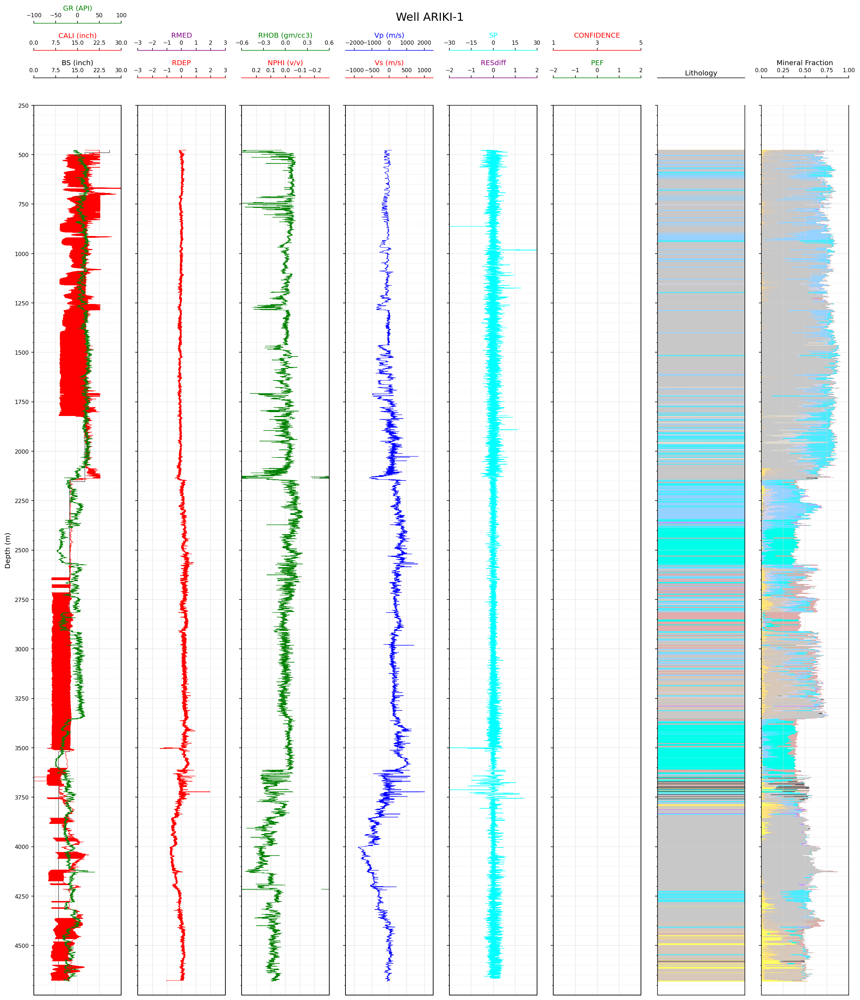

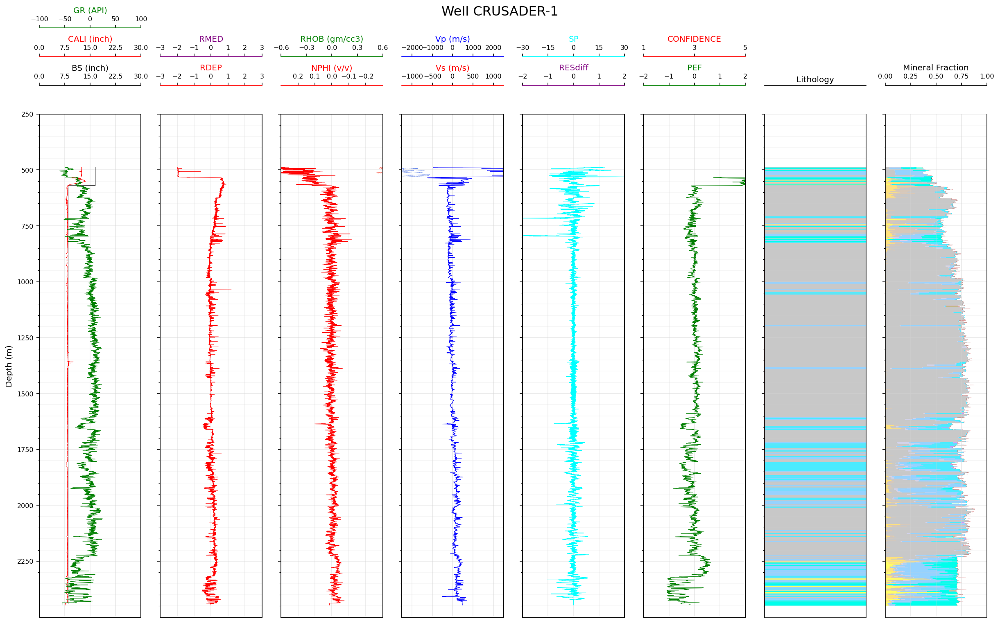

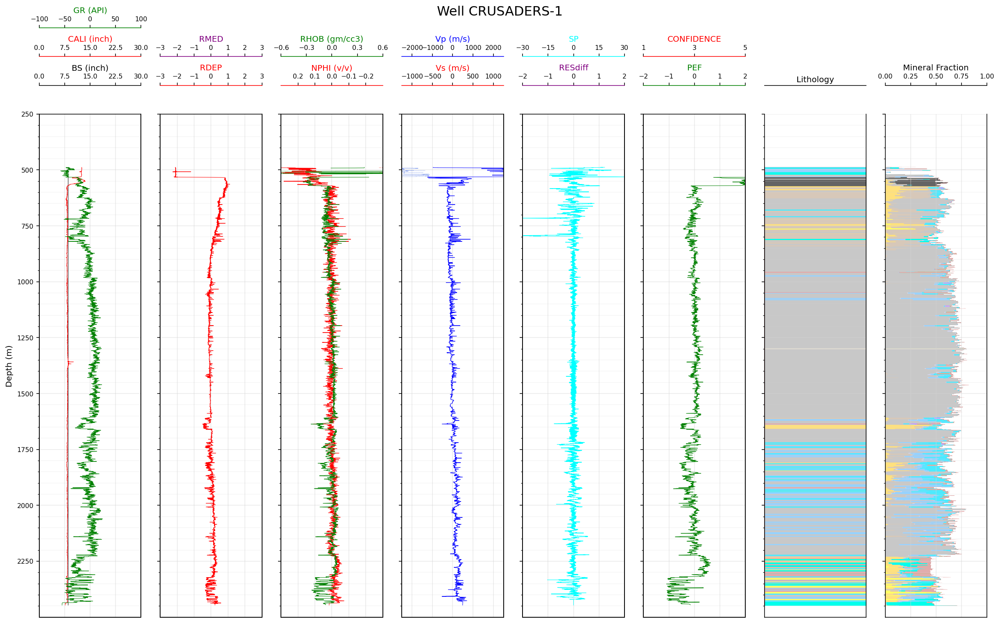

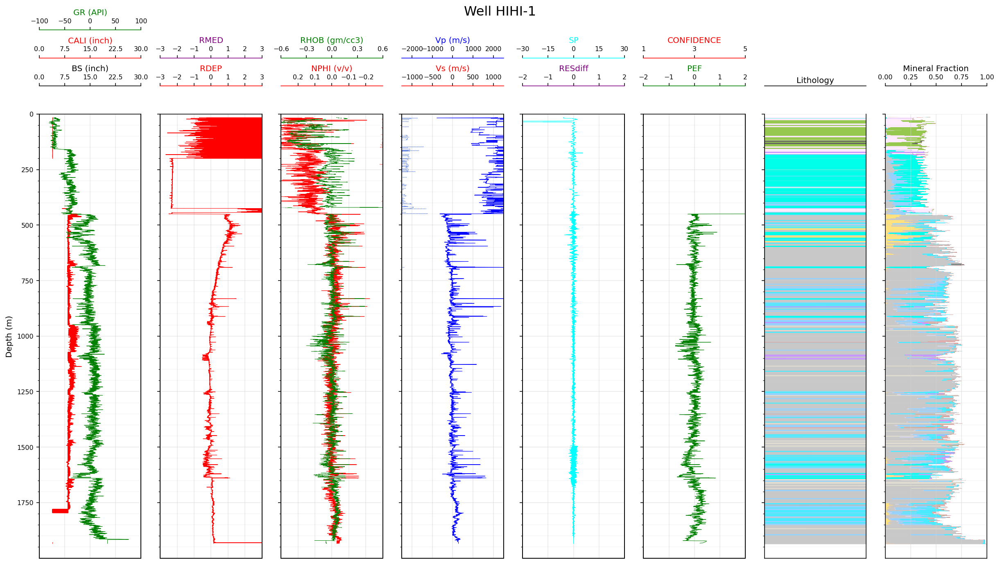

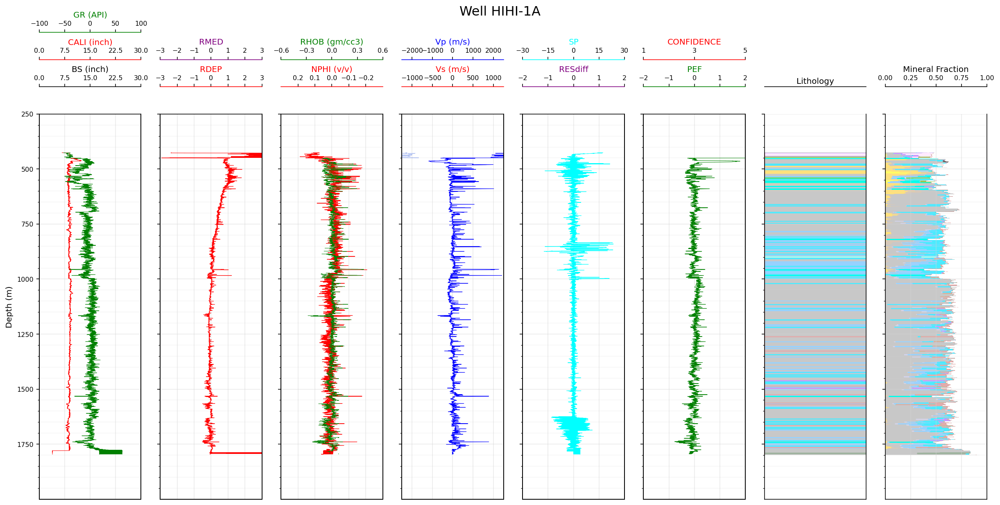

...

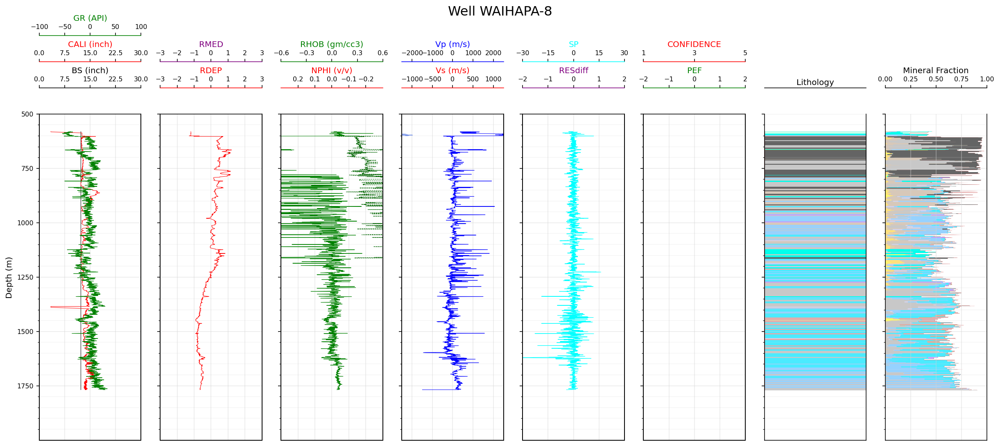

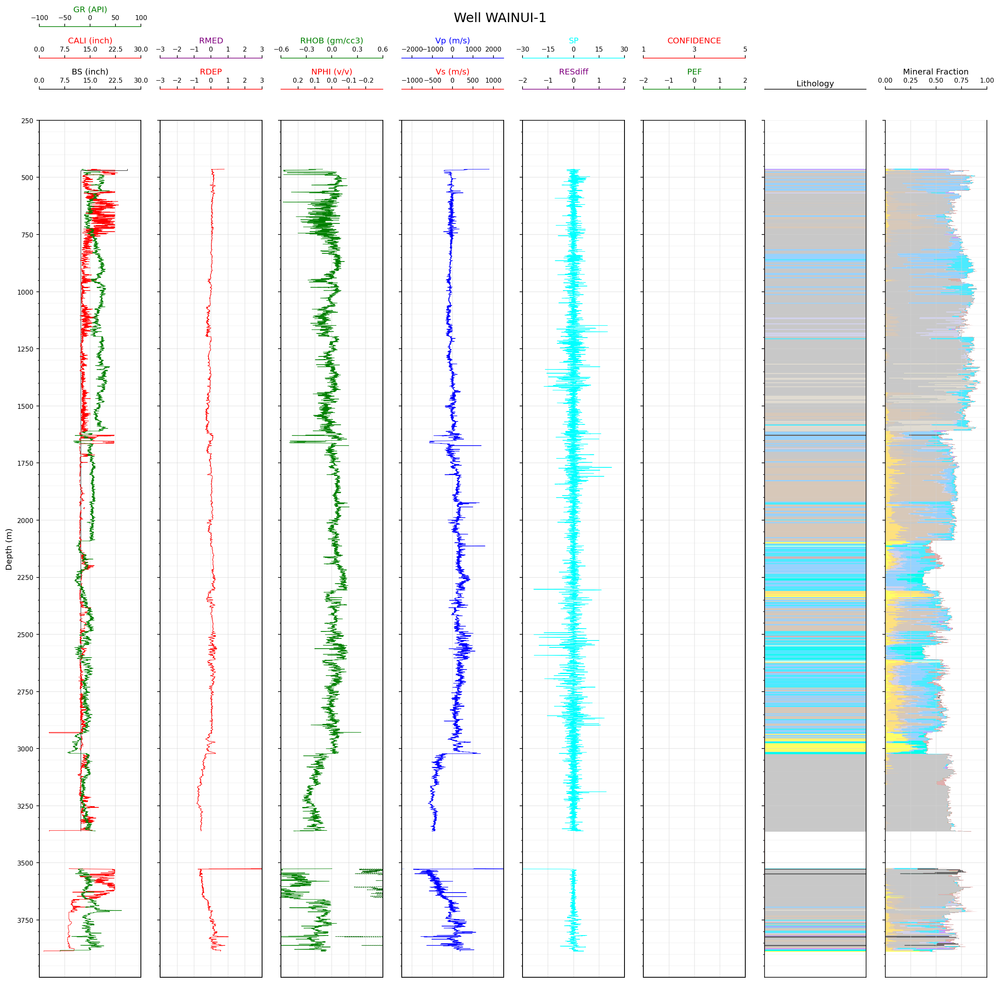

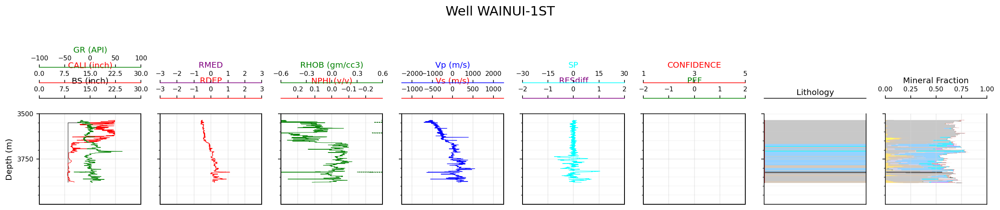

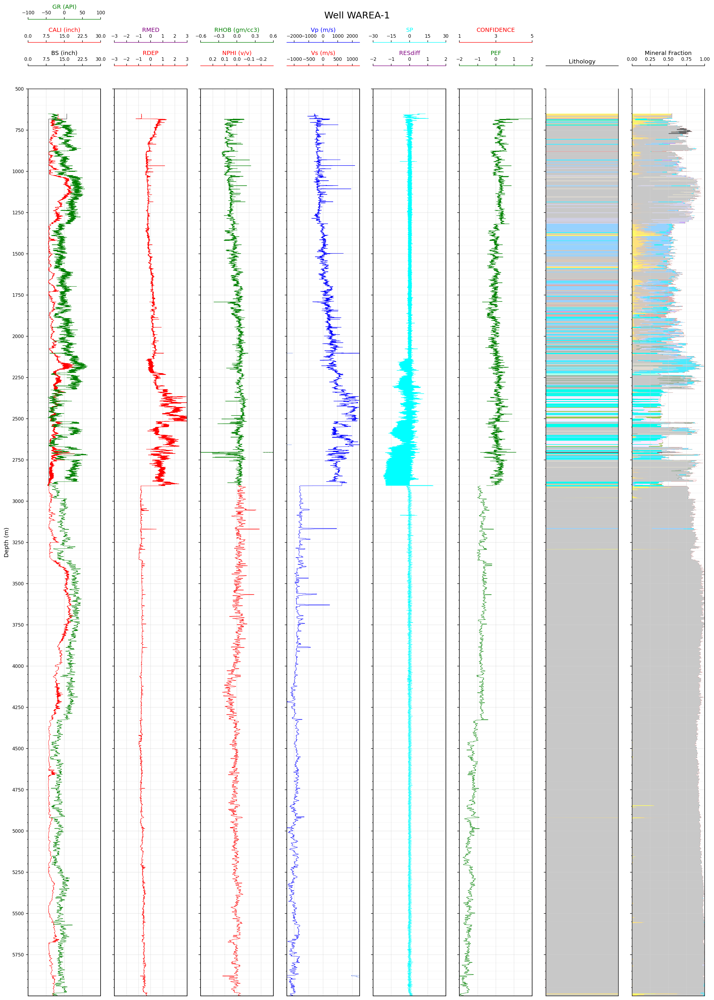

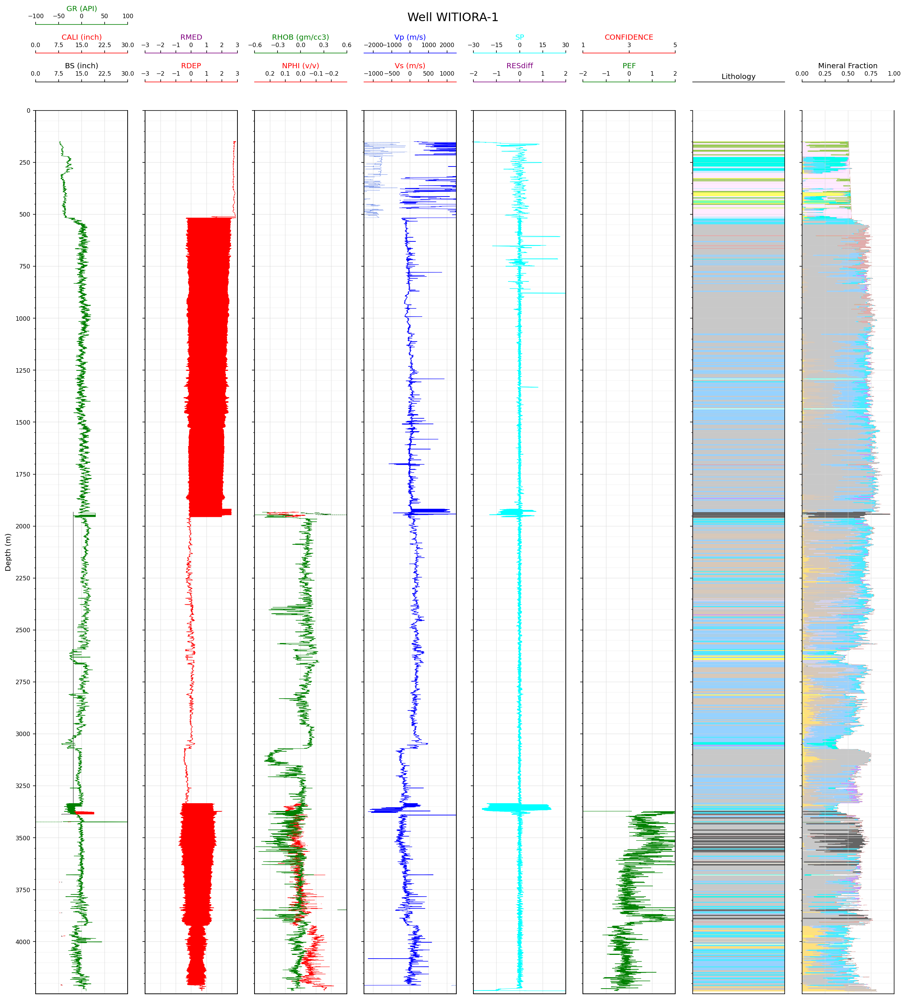

In [ ]:
for i in range(len(Wells)):
  well = Wells[i]
  dataW = dataP[dataP.WELL == well]
  Lithology_log_plot(dataW, dataW.DEPTH, dataW.MINERAL_PRED, mineral_names, mineral_colors, well, 250)

###Convert resistivity back to ohm.m

In [ ]:
data.RDEP = np.power(10,data.RDEP)
data.RMED = np.power(10,data.RMED)
data.RSHA = np.power(10,data.RSHA)

## Save Results

In [ ]:
# Export data prior to analysis but after scaling
print('data saved to directory ')
df = pd.DataFrame(dataP)

nameout = filename.replace(".csv","")

df.to_csv(nameout + '_MC.csv' , sep=';', index=False)

data saved to directory 
